In [42]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn import metrics
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV


pd.set_option('display.max_columns', None)

In [31]:
calverie_train = pd.read_csv('/Users/siucheung/School/Modern Data Analytics/Modern-Data-Analytics-Backend/Dataset/train/train_night_calverie.csv',
                             usecols=['result_timestamp','laeq','night_scale','night_hour','Event_type',
                                    'Weight_Event_Type','Organizer','Respondents','Distance',
                                    'LC_HUMIDITY','LC_DWPTEMP','LC_WINDSPEED','weekday',
                                    'Holiday','downseason','Weight_respondent','Total_Event_Score'])

calverie_test = pd.read_csv('/Users/siucheung/School/Modern Data Analytics/Modern-Data-Analytics-Backend/Dataset/test/test_night_calverie.csv',
                             usecols=['result_timestamp','laeq','night_scale','night_hour','Event_type',
                                    'Weight_Event_Type','Organizer','Respondents','Distance',
                                    'LC_HUMIDITY','LC_DWPTEMP','LC_WINDSPEED','weekday',
                                    'Holiday','downseason','Weight_respondent','Total_Event_Score'])

In [32]:
calverie_train['result_timestamp'] = pd.to_datetime(calverie_train['result_timestamp'])

# EDA

In [33]:
calverie_train['Hour'] = calverie_train['result_timestamp'].dt.hour

In [6]:
fig = px.histogram(calverie_train, x="laeq",nbins=50)
fig.update_layout(title_text='Distribution of sound level: Calverie')
fig.show()

In [7]:
fig = px.histogram(calverie_train, x="LC_HUMIDITY",nbins=50)
fig.update_layout(title_text='Distribution of humidity')
fig.show()

In [8]:
fig = px.histogram(calverie_train, x="LC_DWPTEMP",nbins=50)
fig.update_layout(title_text='Distribution of downtemp')
fig.show()

In [9]:
fig = px.histogram(calverie_train, x="LC_WINDSPEED",nbins=50)
fig.update_layout(title_text='Distribution of windspeed')
fig.show()



In [10]:
fig = px.line(calverie_train, x="result_timestamp", y="LC_WINDSPEED", title='windspeed')
fig.show()

In [11]:
fig = px.box(calverie_train, x="weekday", y="laeq")
fig.update_xaxes(categoryorder='array', categoryarray= ['Monday', 'Tuesday', 'Wednesday',
       'Thursday','Friday', 'Saturday', 'Sunday'])
fig.show()

In [12]:
fig = px.box(calverie_train, x="night_hour", y="laeq")
fig.update_xaxes(categoryorder='array', categoryarray= [0,0.33,0.67,1,1.33,1.67,2,2.33,2.67,3,3.33,
        3.67,4,4.33,4.67,5,5.33,5.67,6,6.33,
        6.67,7,7.33,7.67,8,
        8.33,8.67,9,9.33,9.67,
       10, 10.33,10.67,11, 11.33,
       11.67,12, 12.33, 12.67  ])
fig.show()

In [13]:
fig = px.box(calverie_train, x="Hour", y="laeq")
fig.update_xaxes(categoryorder='array', categoryarray= ['19','20','21','22','23','0','1','2','3','4','5','6','7'])
fig.show()

In [15]:
fig = px.box(calverie_train, x="Organizer", y="laeq")
fig.show()

In [16]:
fig = px.box(calverie_train, x="Event_type", y="laeq")
fig.show()

In [17]:
fig = px.box(calverie_train, x="Holiday", y="laeq")
fig.show()

In [60]:
calverie_train.isna().sum()

result_timestamp        0
laeq                    3
night_scale             0
night_hour              0
Event_type           2988
Weight_Event_Type    2988
Organizer            2988
Respondents          2988
Distance             2988
LC_HUMIDITY             0
LC_DWPTEMP              0
LC_WINDSPEED            0
weekday                 0
Holiday                 0
downseason              0
Weight_respondent    2988
Total_Event_Score       0
Hour                    0
dtype: int64

In [34]:
calverie_train['laeq']= calverie_train['laeq'].interpolate(option='spline')

In [63]:
calverie_train.drop(['result_timestamp','night_scale'],axis=1).corr()

,laeq,night_hour,Weight_Event_Type,Respondents,Distance,LC_HUMIDITY,LC_DWPTEMP,LC_WINDSPEED,Holiday,downseason,Weight_respondent,Total_Event_Score,Hour,Event_type_Cantus,Event_type_Other,Event_type_Party,Event_type_Party_Student,Organizer_Ambiorix,Organizer_Crimen,Organizer_Ekonomika,Organizer_HDR,Organizer_LOKO,Organizer_Politica,Organizer_Recup,Organizer_Rumba,Organizer_VRG,Organizer_t Archief,weekday_Friday,weekday_Monday,weekday_Saturday,weekday_Sunday,weekday_Thursday,weekday_Tuesday,weekday_Wednesday
laeq,1.000000,-0.486761,0.047736,0.067496,-0.089302,-0.357205,0.058413,0.075891,-0.049101,-0.294236,0.056793,0.311720,0.598278,0.074619,0.082143,0.028209,0.149997,-0.057487,0.067491,0.077112,0.085598,-0.009482,0.082616,0.055621,0.052445,0.067559,0.026563,-0.041286,-0.059964,-0.124599,-0.141477,0.183080,0.001872,0.108580
night_hour,-0.486761,1.000000,0.000281,0.002022,-0.003378,0.286080,-0.075315,0.021286,0.000206,-0.002032,0.000185,-0.002145,-0.699075,0.000489,0.000394,-0.002562,-0.002665,0.000379,0.000294,0.000423,-0.004656,0.000178,0.000379,0.000464,-0.003136,0.000437,0.000254,0.005773,0.000641,0.000551,0.000597,-0.007154,0.000663,0.000767
Weight_Event_Type,0.047736,0.000281,1.000000,-0.091265,-0.343293,-0.145902,-0.308883,-0.171001,0.074052,-0.311699,-0.048505,0.316095,-0.000324,0.665335,-0.566763,-0.570918,0.448451,-0.192825,0.190642,-0.092871,0.260935,-0.144563,0.158815,0.150041,-0.450633,0.351536,-0.128270,-0.081724,0.176067,-0.192825,0.095640,-0.076539,0.155076,-0.074723
Respondents,0.067496,0.002022,-0.091265,1.000000,0.210316,0.056859,-0.144773,0.123468,-0.048338,-0.106340,0.499005,0.107673,-0.002334,-0.093964,-0.032923,0.123331,-0.043705,-0.187966,-0.092377,0.237546,-0.135803,-0.052392,-0.067193,-0.099433,0.264569,-0.017859,-0.064847,0.279175,-0.108059,0.100346,-0.091230,0.116245,-0.137703,-0.114568
Distance,-0.089302,-0.003378,-0.343293,0.210316,1.000000,0.016356,0.380653,-0.102851,-0.067156,0.338450,-0.041766,-0.464791,0.003899,-0.185344,-0.149347,0.602760,-0.402235,-0.149429,-0.110999,-0.153839,-0.218238,-0.064129,-0.145269,-0.177703,0.769773,-0.164494,-0.100388,0.246129,-0.197660,0.336933,-0.056203,0.048680,-0.157450,-0.103822
LC_HUMIDITY,-0.357205,0.286080,-0.145902,0.056859,0.016356,1.000000,0.003544,0.003614,-0.017884,0.233800,0.111593,-0.188972,-0.287234,-0.189288,0.051312,-0.104709,-0.068573,-0.004407,-0.114520,-0.011384,-0.006105,0.039419,-0.046808,-0.085017,-0.073930,-0.070901,-0.106277,0.005307,0.073041,-0.011724,-0.015420,0.068967,-0.080720,-0.046256
LC_DWPTEMP,0.058413,-0.075315,-0.308883,-0.144773,0.380653,0.003544,1.000000,0.050581,0.104232,0.190035,-0.142974,-0.292034,0.076370,-0.324870,-0.027361,0.263279,0.021383,0.161355,-0.106993,-0.142551,0.101676,-0.048993,-0.090535,-0.039759,0.165788,-0.114974,0.103074,-0.021164,-0.031610,0.001361,-0.036760,0.009429,0.017570,0.048965
LC_WINDSPEED,0.075891,0.021286,-0.171001,0.123468,-0.102851,0.003614,0.050581,1.000000,-0.038563,0.013575,0.201580,-0.008965,0.009653,-0.067848,0.154626,-0.030357,-0.085118,0.081297,-0.037043,0.060843,-0.064928,0.022111,0.032234,-0.001842,-0.066507,-0.073232,-0.029792,0.006438,-0.103031,0.036105,0.055783,-0.031226,-0.072380,0.109176
Holiday,-0.049101,0.000206,0.074052,-0.048338,-0.067156,-0.017884,0.104232,-0.038563,1.000000,0.028669,-0.056183,-0.033861,-0.000238,-0.038231,-0.030753,-0.080474,0.136779,-0.029573,-0.022960,-0.033016,0.057734,-0.013919,-0.029573,0.204276,-0.065728,-0.034104,-0.019803,-0.044481,0.228695,0.061360,-0.046610,-0.065247,-0.051761,-0.059911
downseason,-0.294236,-0.002032,-0.311699,-0.106340,0.338450,0.233800,0.190035,0.013575,0.028669,1.000000,-0.116078,-0.616640,0.002347,-0.211379,-0.087222,0.056900,-0.407128,0.291555,-0.144614,-0.141267,-0.190436,0.062259,-0.186263,-0.197266,-0.048257,-0.214802,-0.124730,0.048156,0.017754,0.130012,0.057872,-0.095920,-0.024010,-0.082738


/var/folders/f1/lckg4hvs6wv8tfcl39kys4j00000gn/T/ipykernel_12609/1550191556.py:3: DeprecationWarning:

`np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



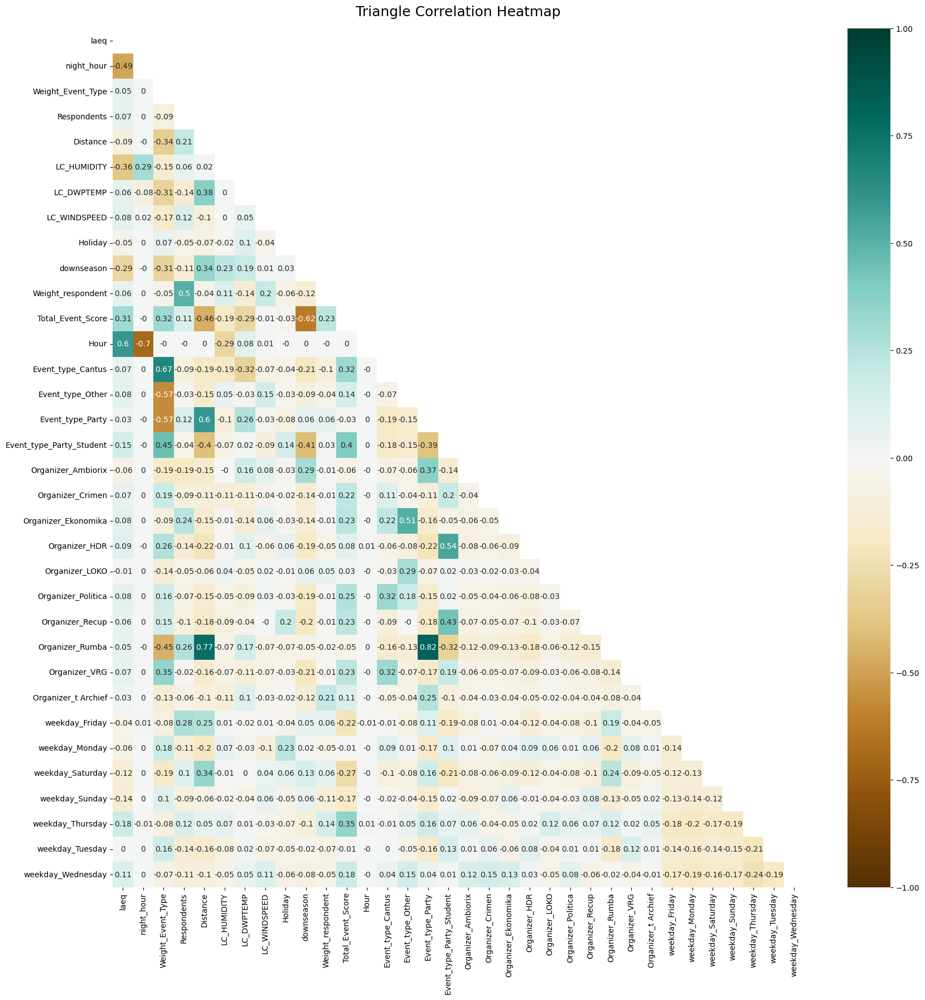

In [64]:
plt.figure(figsize=(20, 20))
# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(calverie_train.drop(['result_timestamp','night_scale'],axis=1).corr(), dtype=np.bool))
heatmap = sns.heatmap(round(calverie_train.drop(['result_timestamp','night_scale'],axis=1).corr(),2), mask=mask, vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Triangle Correlation Heatmap', fontdict={'fontsize':18}, pad=16);

In [35]:
calverie_train = calverie_train.drop(['result_timestamp','night_scale'],axis=1)
calverie_train = pd.get_dummies(calverie_train, columns=['weekday'])

In [36]:
calverie_test['result_timestamp'] = pd.to_datetime(calverie_test['result_timestamp'])
calverie_test['Hour'] = calverie_test['result_timestamp'].dt.hour
calverie_test['laeq']= calverie_test['laeq'].interpolate(option='spline')
calverie_test = pd.get_dummies(calverie_test, columns=['weekday'])

In [37]:
x_train = calverie_train.loc[:, calverie_train.columns != 'laeq']
x_test = calverie_test.loc[:, calverie_test.columns != 'laeq']

y_train = calverie_train['laeq']
y_test = calverie_test['laeq']

#df.loc[:, df.columns != 'b']

In [38]:
x_train = x_train[['downseason','LC_HUMIDITY', 'LC_DWPTEMP', 'LC_WINDSPEED','Total_Event_Score', 'Hour','weekday_Friday', 'weekday_Monday',
       'weekday_Saturday', 'weekday_Sunday', 'weekday_Thursday',
       'weekday_Tuesday', 'weekday_Wednesday']]

x_test = x_test[['downseason','LC_HUMIDITY', 'LC_DWPTEMP', 'LC_WINDSPEED','Total_Event_Score', 'Hour','weekday_Friday', 'weekday_Monday',
       'weekday_Saturday', 'weekday_Sunday', 'weekday_Thursday',
       'weekday_Tuesday', 'weekday_Wednesday']]

In [30]:
x_train.dtypes

downseason             int64
LC_HUMIDITY          float64
LC_DWPTEMP           float64
LC_WINDSPEED         float64
Total_Event_Score    float64
Hour                   int64
weekday_Friday         uint8
weekday_Monday         uint8
weekday_Saturday       uint8
weekday_Sunday         uint8
weekday_Thursday       uint8
weekday_Tuesday        uint8
weekday_Wednesday      uint8
dtype: object

## Decision Tree Regressor (baseline)

In [39]:
regressor = DecisionTreeRegressor(random_state=0)
regressor.fit(x_train,y_train)
regressor.feature_importances_


array([0.10296769, 0.04039759, 0.07575361, 0.04231968, 0.02296014,
       0.59320228, 0.02029108, 0.00424646, 0.02916808, 0.03585917,
       0.01434559, 0.00408134, 0.01440728])

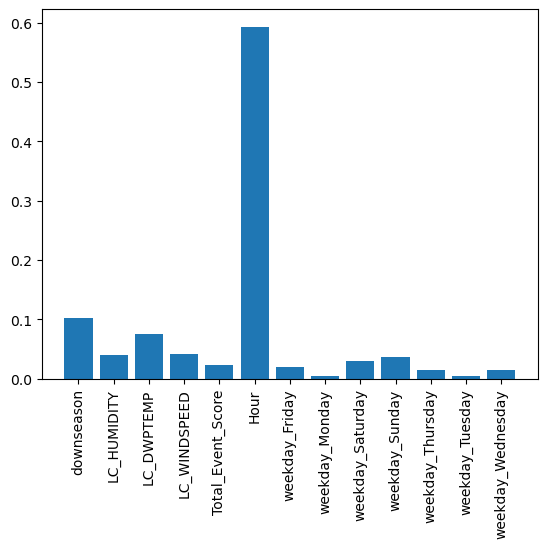

In [75]:
plt.bar(x_train.columns, regressor.feature_importances_)
plt.xticks(rotation=90)

plt.show()

In [40]:
prediction=regressor.predict(x_test)

In [43]:
# r2 and MSE to evaluate the model

print('R2: %.4f' %r2_score(y_test,prediction))
print('MSE: %.4f' %mean_squared_error(y_test,prediction))

R2: 0.4172
MSE: 20.6626


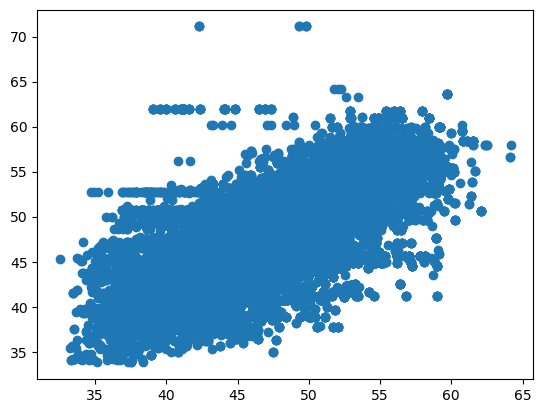

In [44]:
plt.scatter(y_test,prediction)

In [72]:
# Hyper parameters range intialization for tuning 
# https://towardsdatascience.com/hyperparameter-tuning-the-random-forest-in-python-using-scikit-learn-28d2aa77dd74

n_estimators = [int(x) for x in np.linspace(start = 10, stop = 1000, num = 10)]
max_features = ['auto', 'sqrt']
max_depth = [int(x) for x in np.linspace(10, 100, num = 10)] 
max_depth.append(None)
min_samples_split = [2, 5, 10, 20, 30]
min_samples_leaf = [1, 2, 4, 8, 16]
bootstrap = [True, False]


random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}

parameters={"splitter":["best","random"],
            "max_depth" : [1,3,5,7,9,11,12],
           "min_samples_leaf":[1,2,3,4,5,6,7,8,9,10],
           "min_weight_fraction_leaf":[0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9],
           "max_features":["auto","log2","sqrt",None],
           "max_leaf_nodes":[None,10,20,30,40,50,60,70,80,90] }

In [73]:
tuning_model=GridSearchCV(regressor,param_grid=parameters,scoring='neg_mean_squared_error',cv=3,verbose=3)

In [74]:
tuning_model.fit(x_train,y_train)

Fitting 3 folds for each of 50400 candidates, totalling 151200 fits
[CV 1/3] END max_depth=1, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-29.230 total time=   0.0s
[CV 2/3] END max_depth=1, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-21.519 total time=   0.0s
[CV 3/3] END max_depth=1, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-17.095 total time=   0.0s
[CV 1/3] END max_depth=1, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-29.745 total time=   0.0s
[CV 2/3] END max_depth=1, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-23.043 total time=   0.0s
[CV 3/3] END max_depth=1, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fracti

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning:


67200 fits failed out of a total of 151200.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
67200 fits failed with the following error:
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/tree/_classes.py", line 1315, in fit
    super().fit(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/tree/_classes.py", line 304, in fit
    raise ValueError("min_weight_fraction_leaf must in [0, 0.5]")
ValueError: min_weight_fr

GridSearchCV(cv=3, estimator=DecisionTreeRegressor(random_state=0),
             param_grid={'max_depth': [1, 3, 5, 7, 9, 11, 12],
                         'max_features': ['auto', 'log2', 'sqrt', None],
                         'max_leaf_nodes': [None, 10, 20, 30, 40, 50, 60, 70,
                                            80, 90],
                         'min_samples_leaf': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
                         'min_weight_fraction_leaf': [0.1, 0.2, 0.3, 0.4, 0.5,
                                                      0.6, 0.7, 0.8, 0.9],
                         'splitter': ['best', 'random']},
             scoring='neg_mean_squared_error', verbose=3)

In [75]:
tuning_model.best_params_


{'max_depth': 3,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'min_samples_leaf': 1,
 'min_weight_fraction_leaf': 0.1,
 'splitter': 'random'}

In [76]:
tuned_hyper_model= DecisionTreeRegressor(max_depth=3,
                                         max_features='auto',
                                         max_leaf_nodes=None,
                                         min_samples_leaf=1,
                                         min_weight_fraction_leaf=0.1,
                                         splitter='random')

In [77]:
tuned_hyper_model.fit(x_train,y_train)

DecisionTreeRegressor(max_depth=3, max_features='auto',
                      min_weight_fraction_leaf=0.1, splitter='random')

In [78]:
tuned_pred=tuned_hyper_model.predict(x_test)

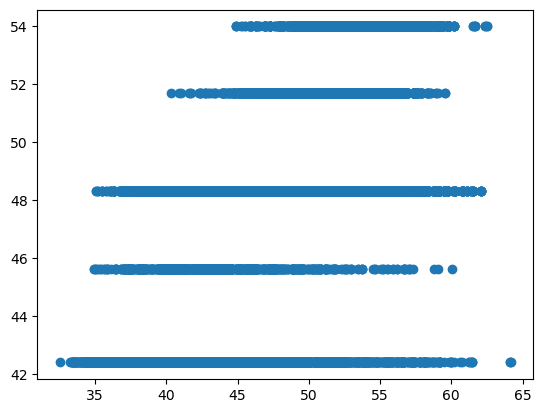

In [79]:
plt.scatter(y_test,tuned_pred)


In [80]:
print('R2: %.4f' %r2_score(y_test,tuned_pred))
print('MSE: %.4f' %mean_squared_error(y_test,tuned_pred))

R2: 0.4429
MSE: 19.7517


## Random Forest (baseline)

In [58]:
rf = RandomForestRegressor()
rf.fit(x_train,y_train)

RandomForestRegressor()

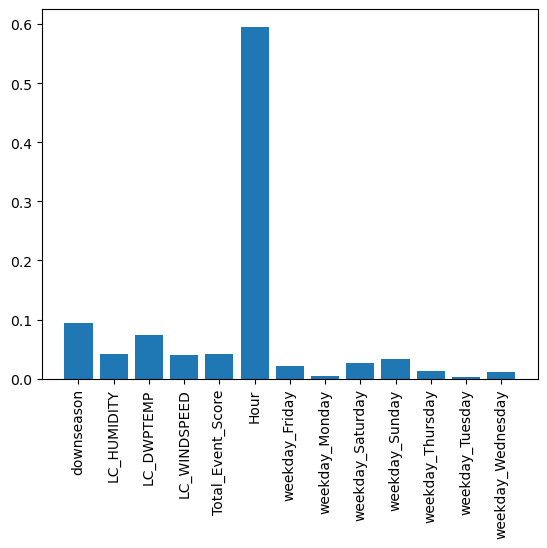

In [59]:
plt.bar(x_train.columns, rf.feature_importances_)
plt.xticks(rotation=90)

plt.show()

In [61]:
prediction = rf.predict(x_test)

In [62]:
# r2 and MSE to evaluate the model

print('R2: %.4f' %r2_score(y_test,prediction))
print('MSE: %.4f' %mean_squared_error(y_test,prediction))

R2: 0.6790
MSE: 11.3822


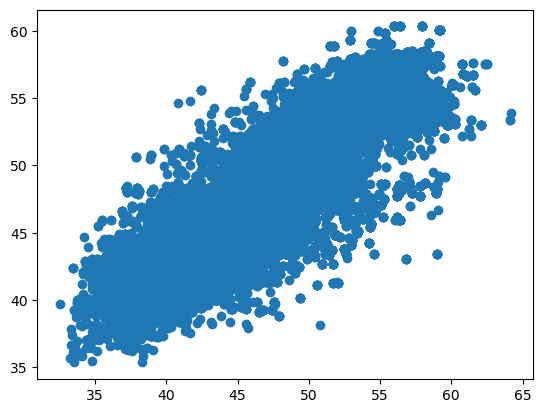

In [63]:
prediction=rf.predict(x_test)
plt.scatter(y_test,prediction)

In [64]:
tuning_model = RandomizedSearchCV(estimator=rf, param_distributions=random_grid, n_iter=100, cv=5, verbose=1, random_state=42, n_jobs=-1)

In [65]:
tuning_model.fit(x_train,y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


/opt/anaconda3/lib/python3.9/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.



RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(), n_iter=100,
                   n_jobs=-1,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [10, 20, 30, 40, 50, 60,
                                                      70, 80, 90, 100, None],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 4, 8, 16],
                                        'min_samples_split': [2, 5, 10, 20, 30],
                                        'n_estimators': [10, 120, 230, 340, 450,
                                                         560, 670, 780, 890,
                                                         1000]},
                   random_state=42, verbose=1)

In [66]:
tuning_model.best_params_

{'n_estimators': 780,
 'min_samples_split': 30,
 'min_samples_leaf': 16,
 'max_features': 'auto',
 'max_depth': 60,
 'bootstrap': True}

In [67]:
tuned_hyper_model= RandomForestRegressor(
    n_estimators=780,
    min_samples_split=30,
    min_samples_leaf=16,
    max_features='auto',
    max_depth=60,
    bootstrap='True')

In [68]:
tuned_hyper_model.fit(x_train,y_train)

RandomForestRegressor(bootstrap='True', max_depth=60, min_samples_leaf=16,
                      min_samples_split=30, n_estimators=780)

In [69]:
tuned_pred=tuned_hyper_model.predict(x_test)

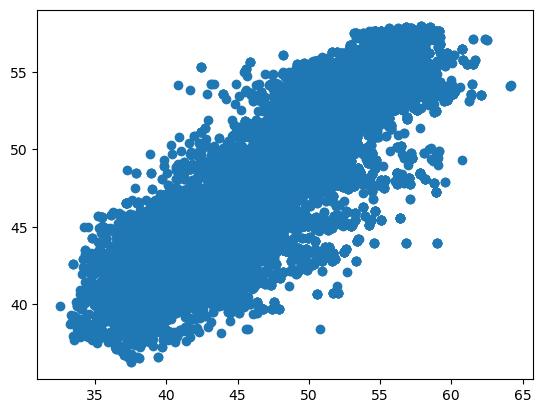

In [70]:
plt.scatter(y_test,tuned_pred)


In [71]:
print('R2: %.4f' %r2_score(y_test,tuned_pred))
print('MSE: %.4f' %mean_squared_error(y_test,tuned_pred))

R2: 0.7006
MSE: 10.6156


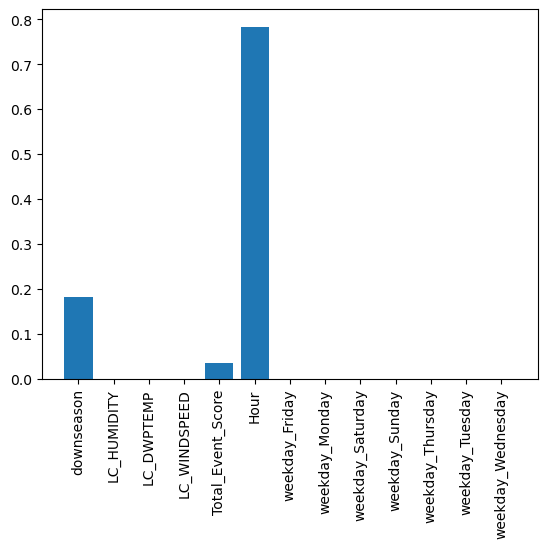

In [81]:
plt.bar(x_train.columns, tuned_hyper_model.feature_importances_)
plt.xticks(rotation=90)

plt.show()

## Adaboost

In [82]:
from sklearn.ensemble import AdaBoostRegressor

In [84]:
# https://thinkingneuron.com/how-to-create-the-adaboost-regression-model-in-python/
boost = AdaBoostRegressor(n_estimators=50 ,learning_rate=1)

In [85]:
boost.fit(x_train,y_train)

AdaBoostRegressor(learning_rate=1)

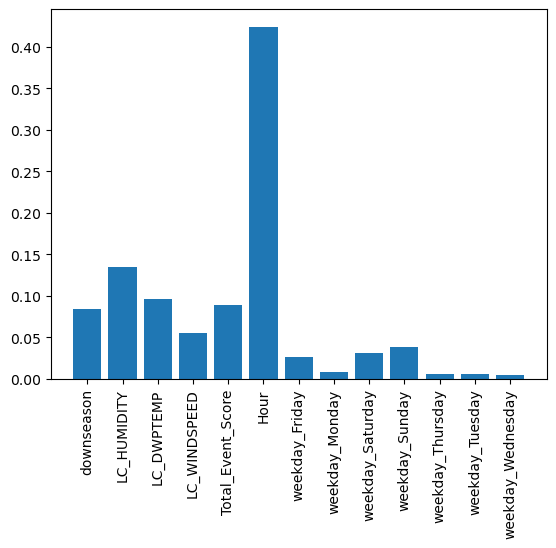

In [89]:
plt.bar(x_train.columns, boost.feature_importances_)
plt.xticks(rotation=90)

plt.show()

In [88]:
prediction=boost.predict(x_test)


In [90]:
print('R2: %.4f' %r2_score(y_test,prediction))
print('MSE: %.4f' %mean_squared_error(y_test,prediction))

R2: 0.5723
MSE: 15.1643


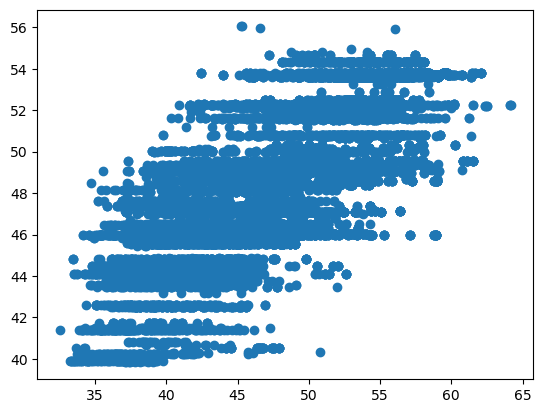

In [91]:
plt.scatter(y_test,prediction)

weakest R2 of all the regressors until now, not worth extra attention

In [ ]:
n_estimators , learning_rate ,  max_depth max_leaf_nodes

# Gradient boosting regression

In [116]:
from sklearn.ensemble import GradientBoostingRegressor

In [117]:
gbr = GradientBoostingRegressor()
gbr.fit(x_train,y_train)

GradientBoostingRegressor()

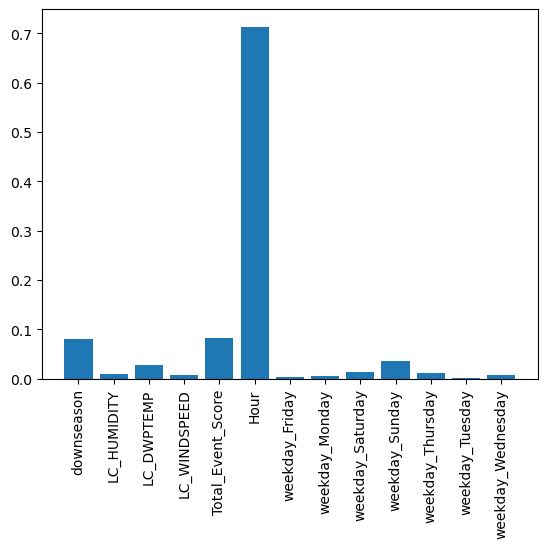

In [118]:
plt.bar(x_train.columns, gbr.feature_importances_)
plt.xticks(rotation=90)

plt.show()

In [119]:
prediction = gbr.predict(x_test)

In [120]:
print('R2: %.4f' %r2_score(y_test,prediction))
print('MSE: %.4f' %mean_squared_error(y_test,prediction))

R2: 0.7131
MSE: 10.1727


In [ ]:
n_estimators = [int(x) for x in np.linspace(start = 10, stop = 1000, num = 10)]
max_features = ['auto', 'sqrt']
max_depth = [int(x) for x in np.linspace(10, 100, num = 10)] 
max_depth.append(None)
min_samples_split = [2, 5, 10, 20, 30]
min_samples_leaf = [1, 2, 4, 8, 16]
bootstrap = [True, False]


random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}